In [ ]:
# En atención a que tengo el dataset en drive, monto el drive
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
# Importo las librerias necesarias
from PIL import Image
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import os
import cv2
import shutil

# **Análisis de la estructura del dataset**

In [ ]:
# Reviso como está estructurado el dataset y visualizo los primeros 5 archivos de cada subcarpeta
carpeta_principal_imagenes= '/content/drive/MyDrive/Proyecto modulo 7/data'

for subcarpeta in os.listdir(carpeta_principal_imagenes):
    sub_carpeta_imagenes = os.path.join(carpeta_principal_imagenes, subcarpeta)
    if os.path.isdir(sub_carpeta_imagenes):
        print(f"Subcarpeta: {subcarpeta}")

        for sub_subcarpeta in os.listdir(sub_carpeta_imagenes):
            sub_sub_carpeta_imagenes = os.path.join(sub_carpeta_imagenes, sub_subcarpeta)
            if os.path.isdir(sub_sub_carpeta_imagenes):
                print(f"  Sub_subcarpeta: {sub_subcarpeta}")

                archivos = [f for f in os.listdir(sub_sub_carpeta_imagenes) if os.path.isfile(os.path.join(sub_sub_carpeta_imagenes, f))]
                primeros_5_archivos = archivos[:5]

                for archivo in primeros_5_archivos:
                    print(f"    Archivo: {archivo}")

Subcarpeta: train
  Sub_subcarpeta: neumonia
    Archivo: person537_virus_1067.jpeg
    Archivo: person53_bacteria_252.jpeg
    Archivo: person537_bacteria_2263.jpeg
    Archivo: person540_bacteria_2272.jpeg
    Archivo: person543_bacteria_2281.jpeg
  Sub_subcarpeta: normal
    Archivo: IM-0523-0001-0003.jpeg
    Archivo: IM-0522-0001.jpeg
    Archivo: IM-0527-0001.jpeg
    Archivo: IM-0523-0001-0002.jpeg
    Archivo: IM-0525-0001-0002.jpeg
Subcarpeta: val
  Sub_subcarpeta: normal
    Archivo: NORMAL2-IM-1431-0001.jpeg
    Archivo: NORMAL2-IM-1427-0001.jpeg
    Archivo: NORMAL2-IM-1430-0001.jpeg
    Archivo: NORMAL2-IM-1442-0001.jpeg
    Archivo: NORMAL2-IM-1438-0001.jpeg
  Sub_subcarpeta: neumonia
    Archivo: person1950_bacteria_4881.jpeg
    Archivo: .DS_Store
    Archivo: person1951_bacteria_4882.jpeg
    Archivo: person1954_bacteria_4886.jpeg
    Archivo: person1946_bacteria_4874.jpeg
Subcarpeta: test
  Sub_subcarpeta: normal
    Archivo: IM-0001-0001.jpeg
    Archivo: IM-0005-000

**Observaciones:**

1. Dentro de la carpeta principal hay 3 subcarpetas: train, test y val.
2. Dentro de cada subcarpeta hay 2 carpetas: normal y neumonia.
3. En las sub subcarpetas "neumonia" se identifica si hay virus o bacteria, y el número del paciente.
4. En la sub subcarpeta "neumonia" de la subcarpeta test se aprecia que hay varias radiografías de una misma persona.
5. En las sub subcarpetas "normal" el número identificador pareciera ser lo que viene después de la expresión "IM-"

# **Análisis exploratorio**

---



### **Visualización y análisis general de los datos**

Subcarpeta: train
  Sub_subcarpeta: normal
    Archivo: IM-0523-0001-0003.jpeg


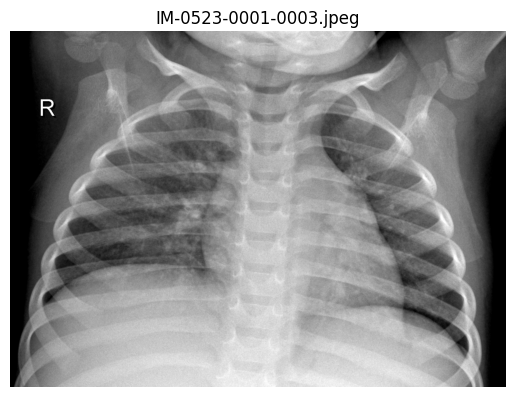

    Archivo: IM-0522-0001.jpeg


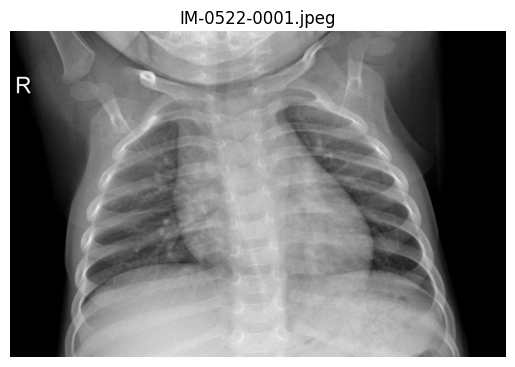

    Archivo: IM-0527-0001.jpeg


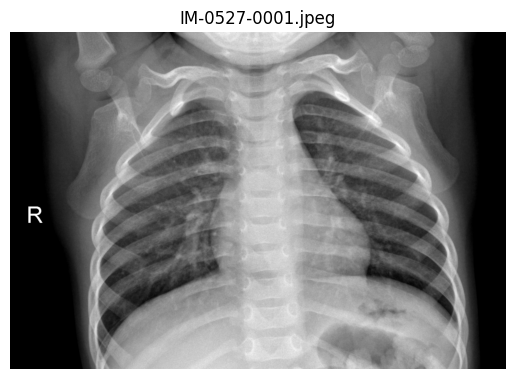

    Archivo: IM-0523-0001-0002.jpeg


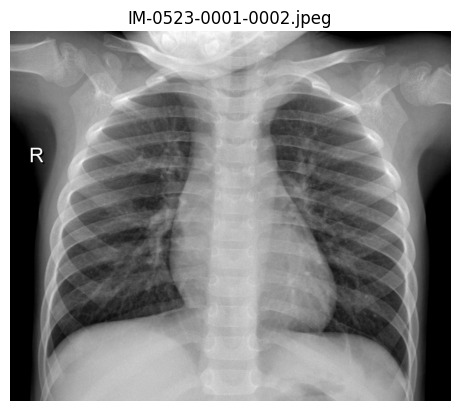

    Archivo: IM-0525-0001-0002.jpeg


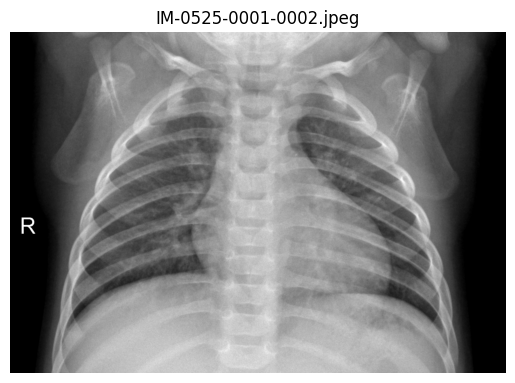

  Sub_subcarpeta: neumonia
    Archivo: person537_virus_1067.jpeg


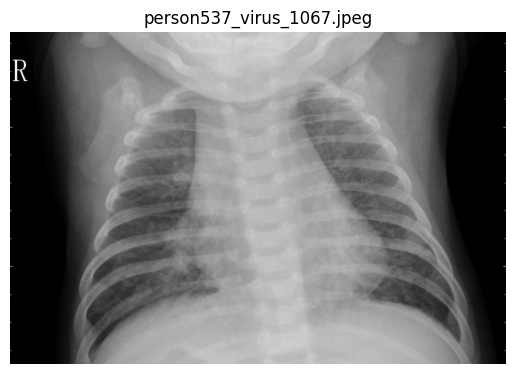

    Archivo: person53_bacteria_252.jpeg


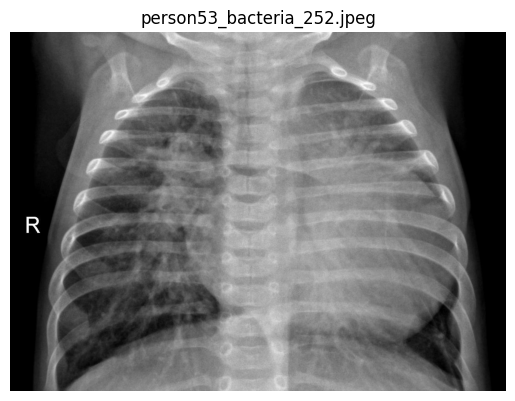

    Archivo: person537_bacteria_2263.jpeg


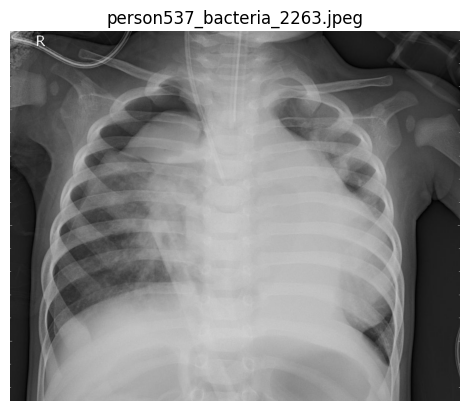

    Archivo: person540_bacteria_2272.jpeg


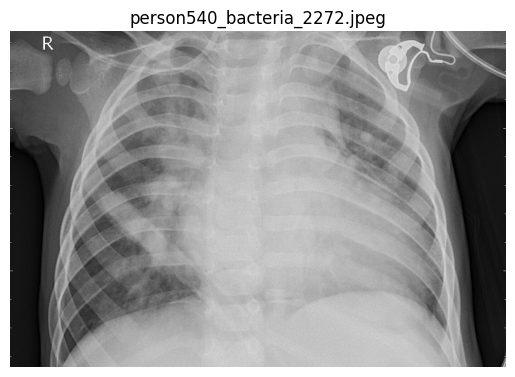

    Archivo: person543_bacteria_2281.jpeg


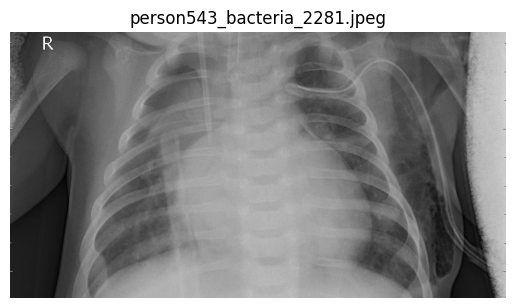

Subcarpeta: val
  Sub_subcarpeta: normal
    Archivo: NORMAL2-IM-1431-0001.jpeg


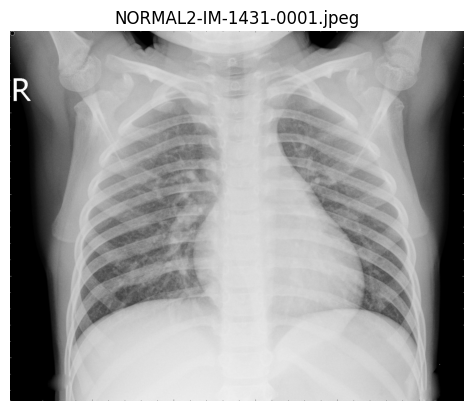

    Archivo: NORMAL2-IM-1427-0001.jpeg


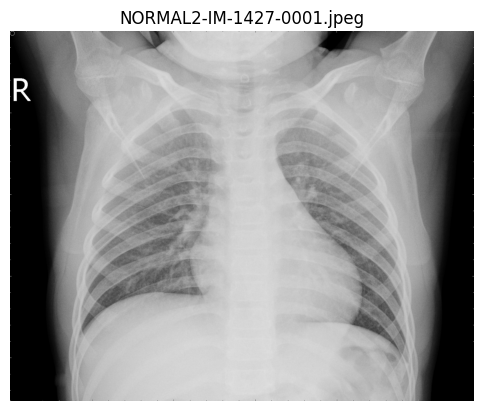

    Archivo: NORMAL2-IM-1430-0001.jpeg


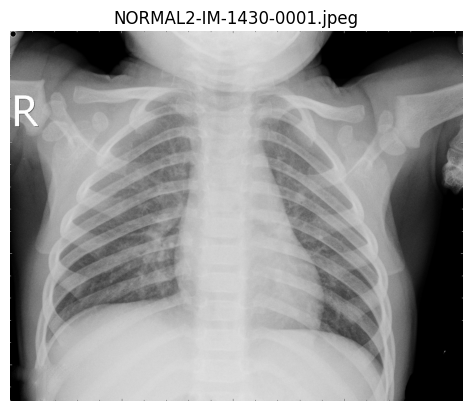

    Archivo: NORMAL2-IM-1442-0001.jpeg


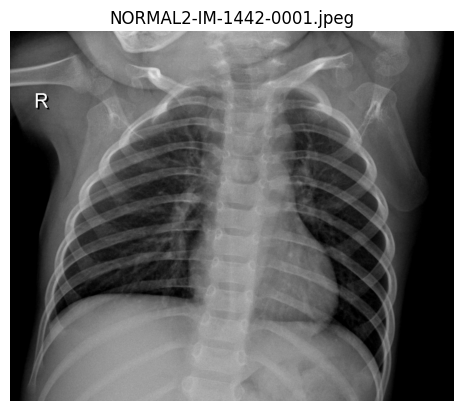

    Archivo: NORMAL2-IM-1438-0001.jpeg


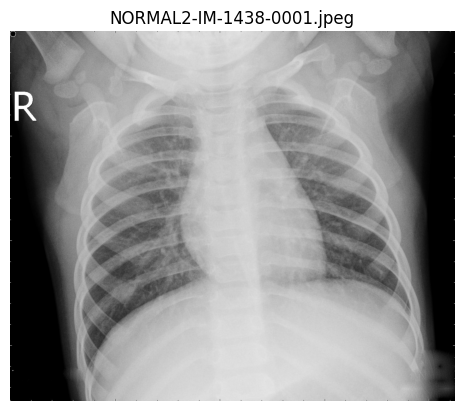

  Sub_subcarpeta: neumonia
    Archivo: person1950_bacteria_4881.jpeg


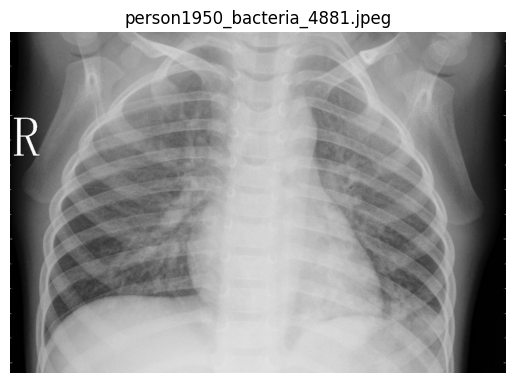

    Archivo: person1951_bacteria_4882.jpeg


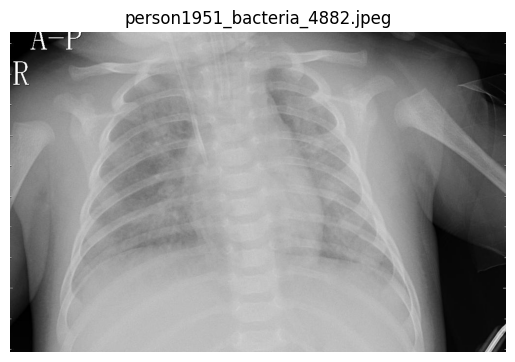

    Archivo: person1954_bacteria_4886.jpeg


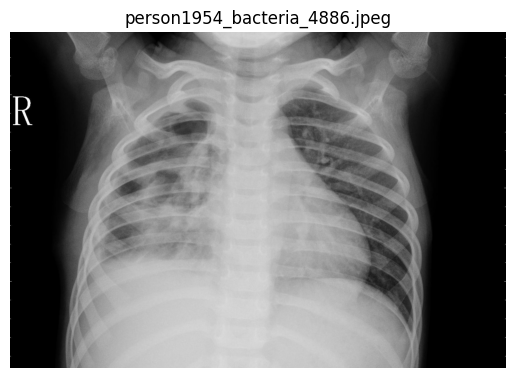

    Archivo: person1946_bacteria_4874.jpeg


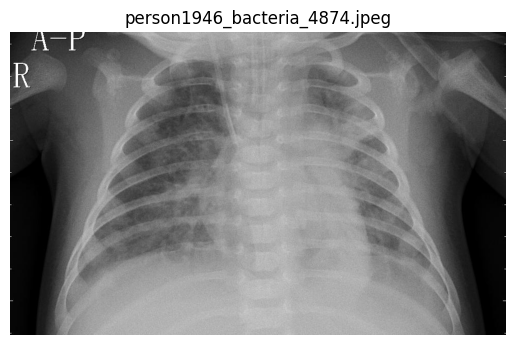

    Archivo: person1952_bacteria_4883.jpeg


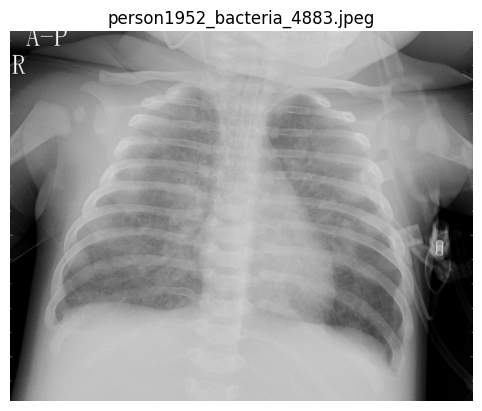

Subcarpeta: test
  Sub_subcarpeta: normal
    Archivo: IM-0001-0001.jpeg


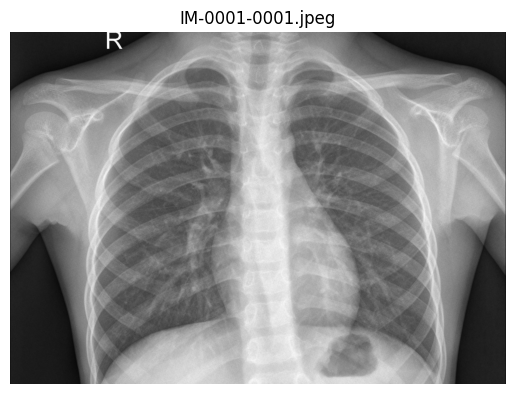

    Archivo: IM-0005-0001.jpeg


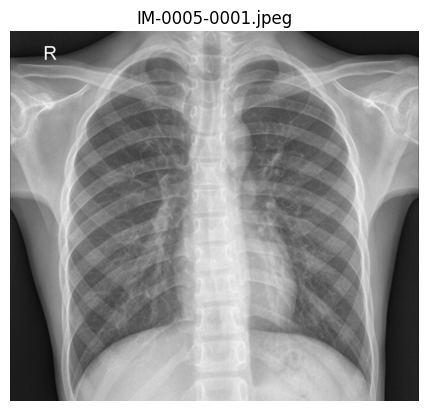

    Archivo: IM-0003-0001.jpeg


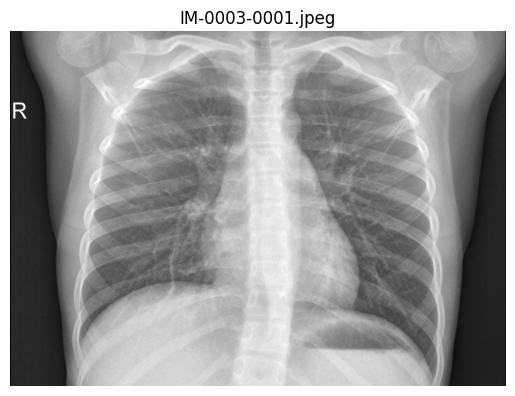

    Archivo: IM-0021-0001.jpeg


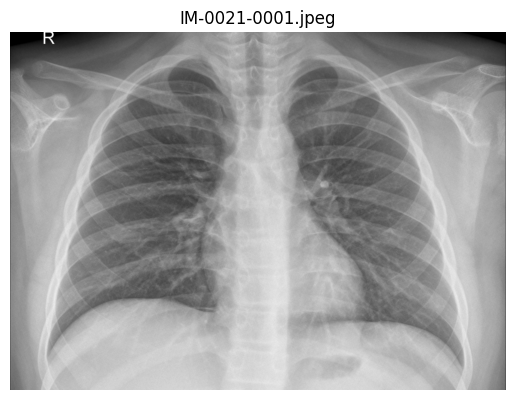

    Archivo: IM-0016-0001.jpeg


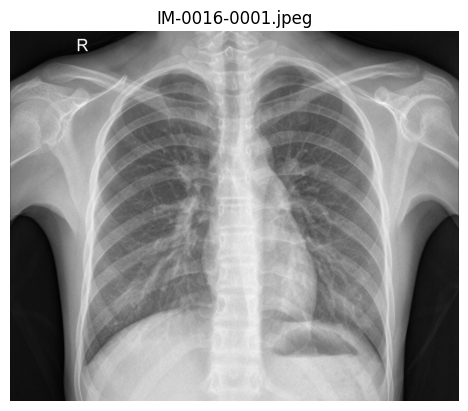

  Sub_subcarpeta: neumonia
    Archivo: person100_bacteria_478.jpeg


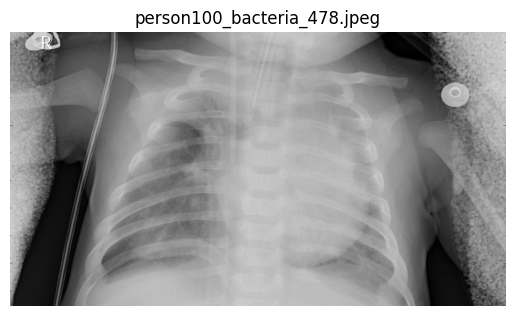

    Archivo: person100_bacteria_475.jpeg


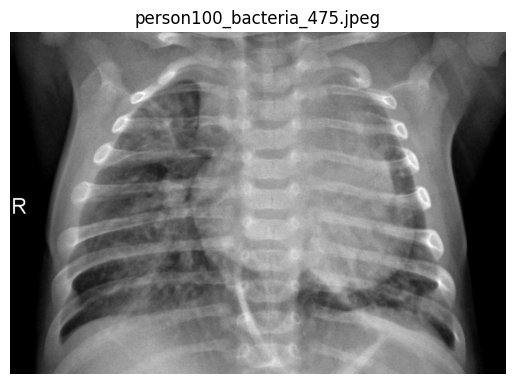

    Archivo: person100_bacteria_479.jpeg


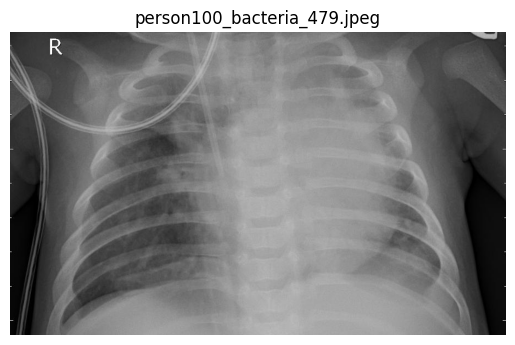

    Archivo: person100_bacteria_480.jpeg


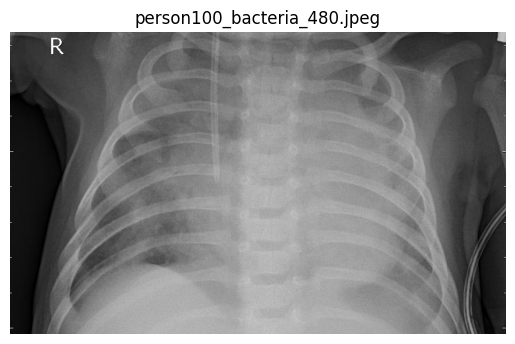

    Archivo: person100_bacteria_481.jpeg


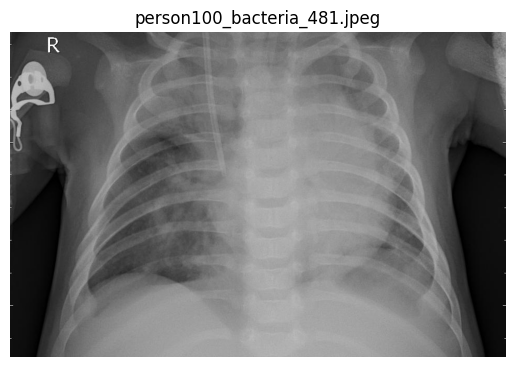

In [ ]:
# Visualizo los archivos, salvo el archivo ".DS_Store" de la carpeta val, que es un archivo de programa

def mostrar_imagenes(imagenes, titulos):
    n = len(imagenes)
    fig, axs = plt.subplots(1, n, figsize=(15, 5))
    if n == 1:
        axs = [axs]
    for i in range(n):
        axs[i].imshow(imagenes[i])
        axs[i].set_title(titulos[i])
        axs[i].axis('off')
    plt.show()

for subcarpeta in os.listdir(carpeta_principal_imagenes):
    sub_carpeta_imagenes = os.path.join(carpeta_principal_imagenes, subcarpeta)
    if os.path.isdir(sub_carpeta_imagenes):
        print(f"Subcarpeta: {subcarpeta}")

        for sub_subcarpeta in os.listdir(sub_carpeta_imagenes):
            sub_sub_carpeta_imagenes = os.path.join(sub_carpeta_imagenes, sub_subcarpeta)
            if os.path.isdir(sub_sub_carpeta_imagenes):
                print(f"  Sub_subcarpeta: {sub_subcarpeta}")

                archivos = [f for f in os.listdir(sub_sub_carpeta_imagenes) if os.path.isfile(os.path.join(sub_sub_carpeta_imagenes, f)) and f != '.DS_Store']
                primeros_5_archivos = archivos[:5]

                for archivo in primeros_5_archivos:
                    print(f"    Archivo: {archivo}")
                    ruta_archivo = os.path.join(sub_sub_carpeta_imagenes, archivo)

                    imagen = cv2.imread(ruta_archivo)
                    plt.imshow(imagen)
                    plt.title(archivo)
                    plt.axis('off')
                    plt.show()

**Observaciones:**

1. En las imágenes de las sub subcarpetas "normal" se ven bien definidos los órganos, las costillas y la columna. También se ve un espacio negro entre las costillas.
2. En las imágenes de las sub subcarpetas "neumonia" no se ven bien definidos los órganos, las costillas y la columna. En algunos casos apenas se ve espacio negro entre las costillas.

In [ ]:
# Creo un dataframe con los siguientes datos de cada imagen: carpeta, categoría, subcategoría, nombre de imagen, ancho, alto, modo y píxeles. Visualizo los primeros 5 archivos
datos_imagenes = []

for carpeta in ['train', 'val', 'test']:
    sub_carpeta_imagenes = os.path.join(carpeta_principal_imagenes, carpeta)
    if os.path.isdir(sub_carpeta_imagenes):
        for categoria in ['neumonia', 'normal']:
            sub_carpeta_categoria = os.path.join(sub_carpeta_imagenes, categoria)
            if os.path.isdir(sub_carpeta_categoria):
                for imagen in os.listdir(sub_carpeta_categoria):
                    if imagen.endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
                        ruta_imagen = os.path.join(sub_carpeta_categoria, imagen)

                        with Image.open(ruta_imagen) as img:
                            ancho, alto = img.size
                            modo = img.mode
                            pixeles = list(img.getdata())

                        if 'virus' in imagen.lower():
                            sub_categoria = 'virus'
                        elif 'bacteria' in imagen.lower():
                            sub_categoria = 'bacteria'
                        else:
                            sub_categoria = 'no hay bacteria ni virus'

                        datos_imagenes.append([carpeta, categoria, sub_categoria, imagen, ancho, alto, modo,pixeles])

columnas = ['Carpeta', 'Categoría', 'Sub categoría', 'Nombre imagen', 'Ancho', 'Alto', 'Modo','Pixeles']
df = pd.DataFrame(datos_imagenes, columns=columnas)

df.to_csv('image_data.csv', index=False)

print(df.head())

  Carpeta Categoría Sub categoría                 Nombre imagen  Ancho  Alto  \
0   train  neumonia         virus     person537_virus_1067.jpeg   1112   744   
1   train  neumonia      bacteria    person53_bacteria_252.jpeg   1292   936   
2   train  neumonia      bacteria  person537_bacteria_2263.jpeg   1216  1000   
3   train  neumonia      bacteria  person540_bacteria_2272.jpeg   1088   736   
4   train  neumonia      bacteria  person543_bacteria_2281.jpeg   1088   584   

  Modo                                            Pixeles  
0    L  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...  
1    L  [0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...  
2    L  [197, 203, 206, 203, 202, 206, 209, 210, 207, ...  
3    L  [87, 82, 79, 80, 75, 65, 60, 62, 61, 65, 68, 6...  
4    L  [62, 66, 66, 66, 72, 84, 90, 88, 72, 83, 99, 9...  


**Observaciones:** la columna de píxeles no entrega información que se relevante para efectos del análisis exploratorio, por lo que no la consideraremos.

In [ ]:
# Muevo el dataframe a la carpeta de drive en la que tengo los datos de mi proyecto

ruta_origen = '/content/image_data.csv'
ruta_destino = '/content/drive/MyDrive/Proyecto modulo 7/image_data.csv'

shutil.move(ruta_origen, ruta_destino)
print(f"Archivo movido a: {ruta_destino}")

Archivo movido a: /content/drive/MyDrive/Proyecto modulo 7/image_data.csv


In [ ]:
# Reviso las primeras 5 filas de mi dataframe
df=pd.read_csv('/content/drive/MyDrive/Proyecto modulo 7/image_data.csv')
df.head()

,Carpeta,Categoría,Sub categoría,Nombre imagen,Ancho,Alto,Modo,Pixeles
0,train,neumonia,virus,person537_virus_1067.jpeg,1112,744,L,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,train,neumonia,bacteria,person53_bacteria_252.jpeg,1292,936,L,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,train,neumonia,bacteria,person537_bacteria_2263.jpeg,1216,1000,L,"[197, 203, 206, 203, 202, 206, 209, 210, 207, ..."
3,train,neumonia,bacteria,person540_bacteria_2272.jpeg,1088,736,L,"[87, 82, 79, 80, 75, 65, 60, 62, 61, 65, 68, 6..."
4,train,neumonia,bacteria,person543_bacteria_2281.jpeg,1088,584,L,"[62, 66, 66, 66, 72, 84, 90, 88, 72, 83, 99, 9..."


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5856 entries, 0 to 5855
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   Carpeta        5856 non-null   object
 1   Categoría      5856 non-null   object
 2   Sub categoría  5856 non-null   object
 3   Nombre imagen  5856 non-null   object
 4   Ancho          5856 non-null   int64 
 5   Alto           5856 non-null   int64 
 6   Modo           5856 non-null   object
 7   Pixeles        5856 non-null   object
dtypes: int64(2), object(6)
memory usage: 366.1+ KB


**Observaciones:** no se observan datos nulos

In [ ]:
# Reviso la cantidad de datos que tiene cada sub carpeta
df['Carpeta'].value_counts()

Carpeta
train    5216
test      624
val        16
Name: count, dtype: int64

### **Revisión y análisis de las dimensiones de las imágenes**

In [ ]:
# Reviso el ancho y alto de las imágenes

print(df['Ancho'].value_counts().sort_index())
print(df['Alto'].value_counts().sort_index())

Ancho
384     1
399     1
400     1
407     1
415     1
       ..
2752    1
2772    1
2844    1
2890    1
2916    1
Name: count, Length: 867, dtype: int64
Alto
127     1
132     1
138     1
140     1
144     1
       ..
2601    1
2625    1
2628    1
2663    1
2713    1
Name: count, Length: 1089, dtype: int64


**Observaciones:** Es posible apreciar que hay imágenes de varios tamaños distintos, por lo que será necesario ajustar el tamaño, para que queden todas del mismo tamaño.

In [ ]:
# Reviso las estadísticas de alto y ancho
print(df['Alto'].describe())
print(df['Ancho'].describe())

count    5856.000000
mean      970.689037
std       383.392117
min       127.000000
25%       688.000000
50%       888.000000
75%      1187.000000
max      2713.000000
Name: Alto, dtype: float64
count    5856.000000
mean     1327.880806
std       363.500922
min       384.000000
25%      1056.000000
50%      1281.000000
75%      1560.000000
max      2916.000000
Name: Ancho, dtype: float64


**Observaciones** En base a las estadísticas, conviene redimensionar las imágenes. En las siguientes celdas analizaremos si es posible utilizar la media del alto (970 píxeles) para redimensionar las imágenes y el ancho lo redimensionaríamos siguiendo las proporciones originales. Por lo anterior:
1. Revisaremos cuántas imágenes tienen un alto menor a 810 píxeles: en este caso si utilizamos la media habría que aumentar el alto en más de un 20%, lo que implicaría reducir la calidad de la imagen.
2. Revisaremos cuántas imágenes tienen un alto mayor a 1455 píxeles: en este caso si utilizamos la media habría que reducir el alto en más de un 50%, lo que implicaría reducir la calidad de la imagen.

In [ ]:
df[df['Alto']<810]

**Observaciones:** el 41% de mi dataset podría sufrir reducción de la calidad si aumento su alto a 970 píxeles, lo que es bastante significativo. Por lo anterior, conviene utilizar un alto menor a 970 píxeles.

In [ ]:
df[df['Alto']>1455]

**Observaciones:** el 11% de mi dataset podría sufrir reducción de la calidad si disminuyo su alto en más de un 50% (i.e. a 970 píxeles). Por tanto, si ajusto el alto en 970 píxeles, en total el 52% de mi dataset podría resultar afectado.

Por lo anterior, siguiendo la lógica mencionada más arriba, a continuación, analizaremos si es posible utilizar como alto 800 píxeles, por lo que revisaremos cuántas imágenes tienen un alto menor a 670 píxeles y un alto mayor a 1200 píxeles.

In [ ]:
df[df['Alto']<670]

**Observaciones**: el 22% de mi dataset podría sufrir reducción de la calidad si aumento su alto a 800 píxeles. Este número si bien es alto, es menor que si aumento el alto a 970 píxeles.

In [ ]:
df[df['Alto']>1200]

**Observaciones:** el 24% de mi dataset podría sufrir reducción de la calidad si disminuyo su alto a 800. Por tanto, si ajusto el alto en 800 píxeles, rn total el 46% de mi dataset podría resultar afectado.

Por lo anterior, revisaremos qué pasa si dejamos el alto en 850 píxeles, por lo que, a continuación, siguiendo la lógica indicada más arriba, revisaremos cuántas imágenes tienen un alto menor a 709 píxeles y mayor a 1275 píxeles.

In [ ]:
df[df['Alto']<709]

**Observaciones:** el 27,5% de mi dataset podría sufrir reducción de la calidad si aumento su alto a 850 píxeles.



In [ ]:
df[df['Alto']>1275]

**Observaciones:** el 19,9% de mi dataset podría sufrir reducción de la calidad si disminuyo su alto a 850 píxeles. Por tanto, si ajusto el alto en 850 píxeles, el 47,4% de mi dataset podría resultar afectado, lo que es levemente mayor al resultado que se obtiene si consideramos un alto de 800 píxeles.

Así las cosas, en el caso de las imágenes que tienen un alto igual o mayor a 670 píxeles, pero igual o menor a 1200 píxeles, fijaremos un alto de 800 píxeles. En el caso de las imágenes que tienen un alto menor a 670 píxeles, utilizaremos un alto de 447 píxeles y si el alto es mayor a 1200 píxeles, utilizaremos un alto de 1440 píxeles, ya que, según veremos a continuación, en ese escenario menos de 3% del data podría sufrir una reducción considerable de su calidad.

In [ ]:
# Revisamos aquellas imágenes que tienen un alto menor a 373
df[df['Alto']<373]

**Observaciones:** el 1,7% de mi dataset podría sufrir reducción de la calidad si aumento su alto a 447 píxeles, que sería más de un 20% de su alto original.

In [ ]:
# Revisamos aquellas imágenes que tienen un alto mayor a 2160
df[df['Alto']>2160]

In [ ]:
num_filas = len(df[df['Alto'] > 2160])

print(f"El número de filas con 'Alto' mayor a 2160 es: {num_filas}")

El número de filas con 'Alto' mayor a 2160 es: 55


**Observaciones:** el 0,9% de mi dataset podría sufrir reducción de la calidad si disminuyo su alto a 1440 píxeles, que sería más de un 50% de su alto original.

In [ ]:
# A continuación definiré la funciones que utilizaré para redimensionar las imágenes, según los altos antes indicados y el ancho lo ajustaré según las proporciones de la imagen original, sólo para revisar si hay pérdida de calidad

def nuevo_alto_deseado(imagen):
    alto_original, ancho_original, _ = imagen.shape
    if alto_original<670:
      nuevo_alto_deseado = 447
    elif alto_original>1200:
      nuevo_alto_deseado = 1440
    else:
      nuevo_alto_deseado = 800
    return nuevo_alto_deseado

def redimensionar_imagenes(imagen, nuevo_alto_deseado):
    alto_original, ancho_original, _ = imagen.shape
    factor_redimensionamiento = nuevo_alto_deseado / alto_original
    nuevo_ancho = int(ancho_original * factor_redimensionamiento)
    imagen_redimensionada = cv2.resize(imagen, (nuevo_ancho, nuevo_alto_deseado))
    return imagen_redimensionada

In [ ]:
# Selecciono y visualizo 3 imágenes cuyo alto es mayor a 373 y menor a 2160
df.iloc[[0,4,14]]

,Carpeta,Categoría,Sub categoría,Nombre imagen,Ancho,Alto,Modo,Pixeles
0,train,neumonia,virus,person537_virus_1067.jpeg,1112,744,L,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,train,neumonia,bacteria,person543_bacteria_2281.jpeg,1088,584,L,"[62, 66, 66, 66, 72, 84, 90, 88, 72, 83, 99, 9..."
14,train,neumonia,virus,person544_virus_1078.jpeg,1864,1544,L,"[15, 15, 15, 15, 15, 15, 15, 15, 14, 14, 14, 1..."


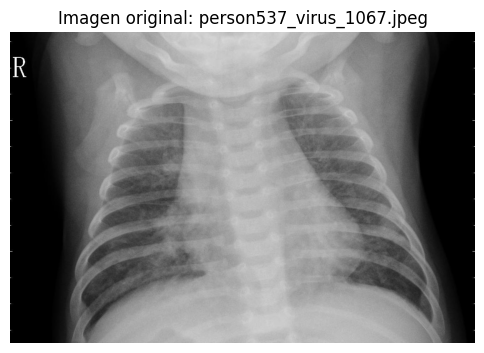

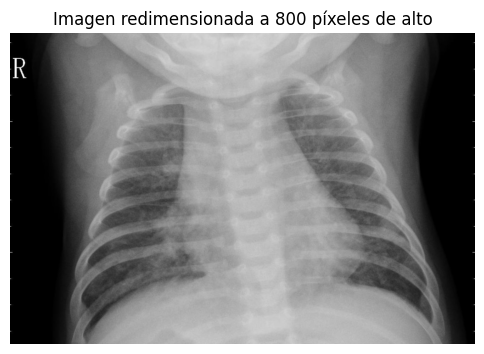

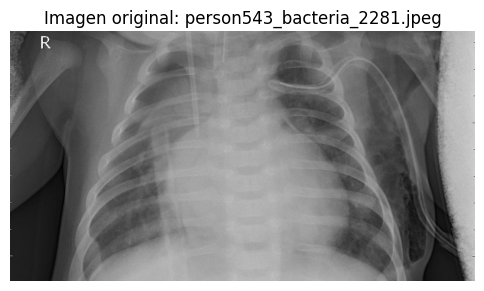

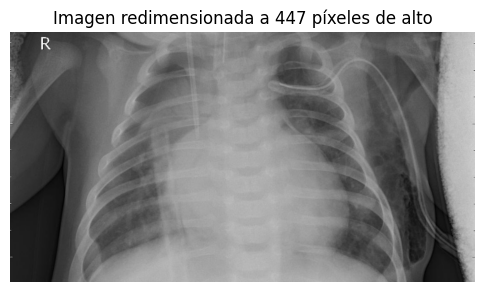

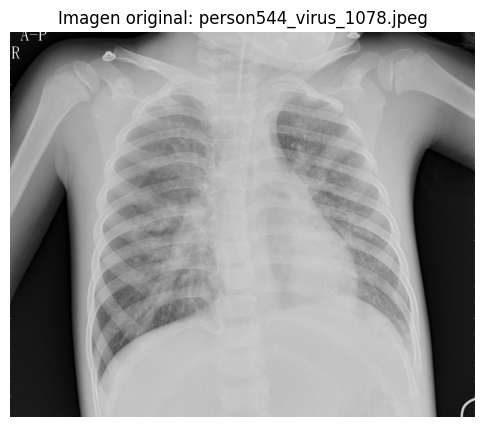

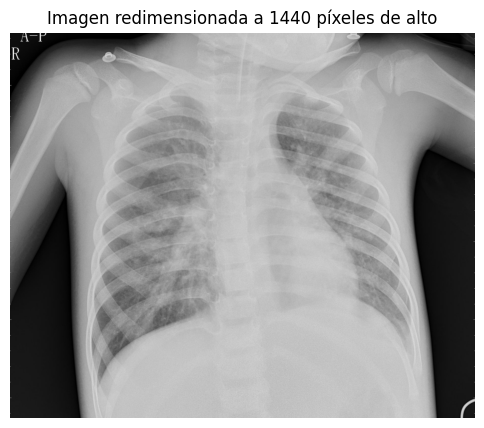

In [ ]:
# Revisamos si el redimensionamiento afecta la calidad de las imágenes seleccionadas, conforme a los valores definidos
ejemplos_imagenes = [
    {'carpeta': 'train', 'categoria': 'neumonia', 'nombre_imagen': 'person537_virus_1067.jpeg'},
    {'carpeta': 'train', 'categoria': 'neumonia', 'nombre_imagen': 'person543_bacteria_2281.jpeg'},
    {'carpeta': 'train', 'categoria': 'neumonia', 'nombre_imagen': 'person544_virus_1078.jpeg'}
]

for ejemplo in ejemplos_imagenes:
    carpeta = ejemplo['carpeta']
    categoria = ejemplo['categoria']
    nombre_imagen = ejemplo['nombre_imagen']
    ruta_imagen = os.path.join(carpeta_principal_imagenes, carpeta, categoria, nombre_imagen)

    imagen_original = cv2.imread(ruta_imagen)

    plt.figure(figsize=(6, 6))
    plt.imshow(imagen_original)
    plt.title(f'Imagen original: {nombre_imagen}')
    plt.axis('off')
    plt.show()

    imagen_redimensionada = redimensionar_imagenes(imagen_original, nuevo_alto_deseado(imagen_original))

    plt.figure(figsize=(6, 6))
    plt.imshow(imagen_redimensionada)
    plt.title(f'Imagen redimensionada a {nuevo_alto_deseado(imagen_original)} píxeles de alto')
    plt.axis('off')
    plt.show()

**Observaciones:** En los ejemplos de prueba no se aprecia pérdida de calidad de las imágenes, por lo que es razonable utilizar los valores antes definidos.

In [ ]:
# Selecciono y visualizo una imagen cuyo alto es menor a 373 y una imagen cuyo alto es mayor a 2160
df.iloc[[786,4295]]

,Carpeta,Categoría,Sub categoría,Nombre imagen,Ancho,Alto,Modo,Pixeles
786,train,neumonia,bacteria,person888_bacteria_2812.jpeg,527,219,RGB,"[(60, 60, 60), (59, 59, 59), (57, 57, 57), (56..."
4295,train,normal,no hay bacteria ni virus,NORMAL2-IM-0587-0001-0002.jpeg,2428,2540,L,"[1, 2, 4, 5, 5, 4, 4, 6, 3, 2, 3, 4, 4, 3, 3, ..."


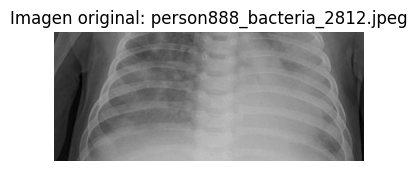

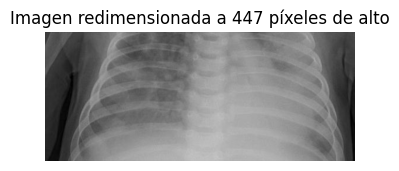

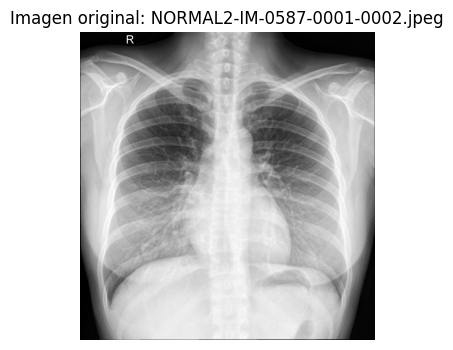

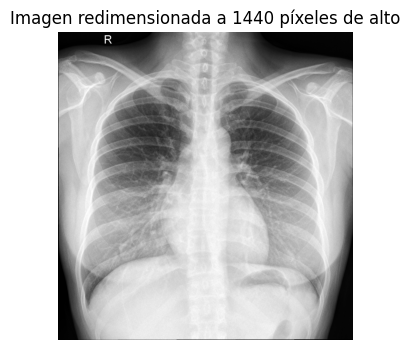

In [ ]:
# Revisamos si el redimensionamiento afecta mucho la calidad de las imágenes seleccionadas, conforme a los valores definidos
ejemplos_imagenes_2 = [
    {'carpeta': 'train', 'categoria': 'neumonia', 'nombre_imagen': 'person888_bacteria_2812.jpeg'},
    {'carpeta': 'train', 'categoria': 'normal', 'nombre_imagen': 'NORMAL2-IM-0587-0001-0002.jpeg'},
]

for ejemplo in ejemplos_imagenes_2:
    carpeta = ejemplo['carpeta']
    categoria = ejemplo['categoria']
    nombre_imagen = ejemplo['nombre_imagen']
    ruta_imagen = os.path.join(carpeta_principal_imagenes, carpeta, categoria, nombre_imagen)

    imagen_original = cv2.imread(ruta_imagen)

    plt.figure(figsize=(4, 4))
    plt.imshow(imagen_original)
    plt.title(f'Imagen original: {nombre_imagen}')
    plt.axis('off')
    plt.show()

    imagen_redimensionada = redimensionar_imagenes(imagen_original, nuevo_alto_deseado(imagen_original))

    plt.figure(figsize=(4, 4))
    plt.imshow(imagen_redimensionada)
    plt.title(f'Imagen redimensionada a {nuevo_alto_deseado(imagen_original)} píxeles de alto')
    plt.axis('off')
    plt.show()

**Observaciones:** en los ejemplos analizados no se aprecia una pérdida significativa de la calidad de la imagen, por lo que es razonable utilizar los valores antes definidos.

### **Revisión y análisis del modo o formato de las imágenes**

In [ ]:
# Reviso qué modos hay
df['Modo'].value_counts()

Modo
L      5573
RGB     283
Name: count, dtype: int64

**Observaciones:** la gran mayoría de las imágenes está en escala de grises (L) y unas pocas imágenes están a color (RGB).

### **Revisión y análisis del balanceo de las categorías y subcategorías**

In [ ]:
# Reviso la cantidad de datos que tiene cada sub subcarpeta de mi conjunto de entrenamiento y las subcategorias que definí antes
df_train=df[df['Carpeta']=='train']
print(df_train['Categoría'].value_counts())
print(df_train['Sub categoría'].value_counts())

Categoría
neumonia    3875
normal      1341
Name: count, dtype: int64
Sub categoría
bacteria                    2530
virus                       1345
no hay bacteria ni virus    1341
Name: count, dtype: int64


**Observaciones:**
1. Existe un claro desbalanceo entre la categoría de neumonia y normal. La cantidad de imágenes de la categoría "neumonia" casi triplica la cantidad de imágenes de la categoría "normal".
2. En las sub categorias, la cantidad de imágenes en las que no hay bacteria ni virus es igual que la cantidad de imágenes de la categoría "normal", por lo que está ok. No obstante, la cantidad de imágenes de la subcategoría virus es casi la mitad de  la cantidad de imágenes de la subcategoría bacteria.

Categoría
neumonia    74.290644
normal      25.709356
Name: count, dtype: float64


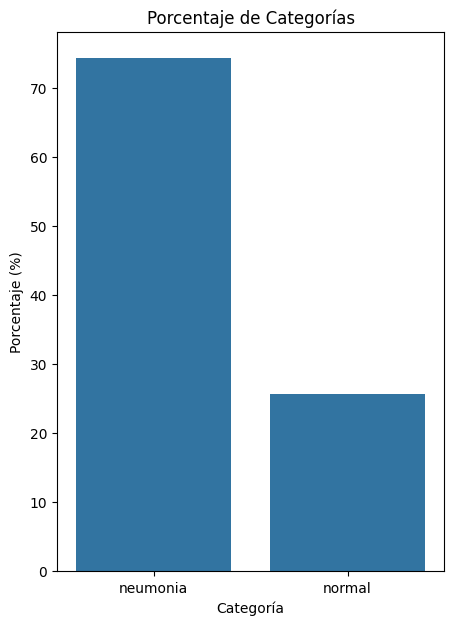

In [ ]:
# Calculo el porcentaje que representa cada categoría dentro del total del conjunto de entrenamiento y lo grafico

contador_categorias=df_train['Categoría'].value_counts()
porcentaje_categorias=contador_categorias/contador_categorias.sum()*100
print(porcentaje_categorias)

fig, ax = plt.subplots(figsize=(5, 7))

sns.barplot(x=porcentaje_categorias.index, y=porcentaje_categorias.values,ax=ax)
ax.set_title('Porcentaje de Categorías')
ax.set_xlabel('Categoría')
ax.set_ylabel('Porcentaje (%)')

plt.show()

**Observaciones:** Con el gráfico se comprueba el desbalanceo de las categorías del conjunto de entrenamiento, ya que neumonía representa casi el 74% de los datos de entrenamiento y normal sólo el 26%.

No obstante, por el peso de las imágenes, haré un sub muestreo de ambas categorías, procurando que en la submuestra queden balanceadas.

Sub categoría
bacteria    65.290323
virus       34.709677
Name: count, dtype: float64


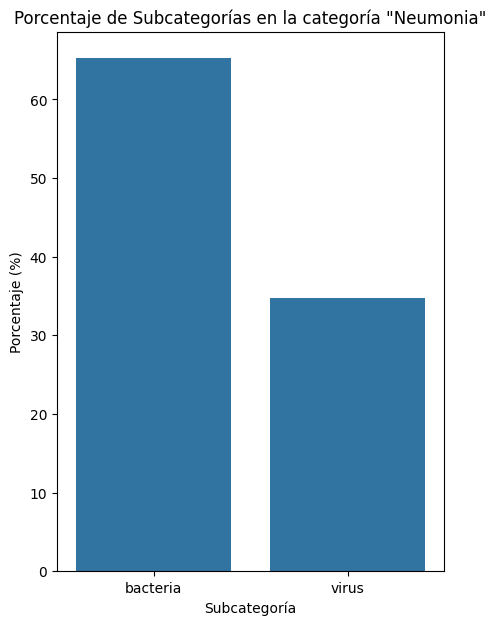

In [ ]:
# Calculo el porcentaje que representa cada sub categoría dentro del total de personas con neumonía del conjunto de entrenamiento y lo grafico

df_neumonia=df_train[(df_train['Categoría'] == 'neumonia') & (df_train['Sub categoría'].isin(['bacteria', 'virus']))]

contador_subcategorias=df_neumonia['Sub categoría'].value_counts()
porcentaje_subcategorias=contador_subcategorias/contador_subcategorias.sum()*100
print(porcentaje_subcategorias)

fig, ax = plt.subplots(figsize=(5, 7))

sns.barplot(x=porcentaje_subcategorias.index, y=porcentaje_subcategorias.values,ax=ax)
ax.set_title('Porcentaje de Subcategorías en la categoría "Neumonia"')
ax.set_xlabel('Subcategoría')
ax.set_ylabel('Porcentaje (%)')

plt.show()

**Observaciones:** se aprecia un desbalanceo entre las sub categorias de neumonia, ya que bacteria representa un 65% y virus sólo un 35%. No obstante, ello se podría explicar por el hecho que es más común la neumonía bacteriana que la viral. Por lo anterior, para reducir el desbalanceo, en el sub muestreo de la categoría neumonia consideraré un 55% de bacteria y un 45% de virus.

In [ ]:
# Reviso la cantidad de datos que tiene cada sub subcarpeta de mi conjunto de prueba y las subcategorias que definí antes
df_test=df[df['Carpeta']=='test']
print(df_test['Categoría'].value_counts())
print(df_test['Sub categoría'].value_counts())

Categoría
neumonia    390
normal      234
Name: count, dtype: int64
Sub categoría
bacteria                    242
no hay bacteria ni virus    234
virus                       148
Name: count, dtype: int64


**Observaciones:** en este caso también se observa un desbalanceo entre las categorías "neumonia" y "normal" y entre las subcategorías de neumonia.

Categoría
neumonia    62.5
normal      37.5
Name: count, dtype: float64


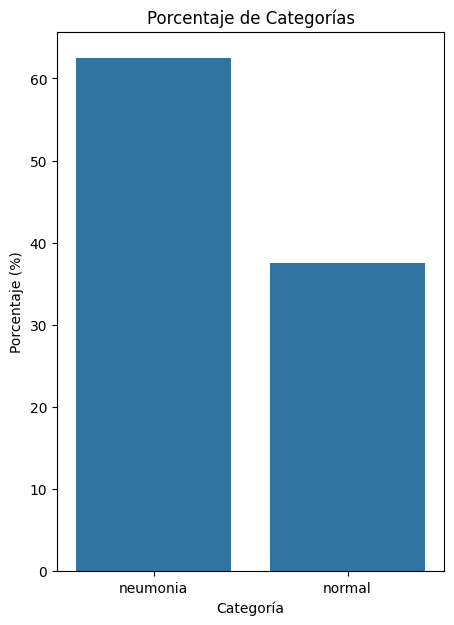

In [ ]:
# Calculo el porcentaje que representa cada categoría dentro del total del conjunto de prueba y grafico

contador_categorias=df_test['Categoría'].value_counts()
porcentaje_categorias=contador_categorias/contador_categorias.sum()*100
print(porcentaje_categorias)

fig, ax = plt.subplots(figsize=(5, 7))

sns.barplot(x=porcentaje_categorias.index, y=porcentaje_categorias.values,ax=ax)
ax.set_title('Porcentaje de Categorías')
ax.set_xlabel('Categoría')
ax.set_ylabel('Porcentaje (%)')

plt.show()

**Observaciones:** Si bien las clategorías están desbalanceadas, es tolerable.

# **Conclusiones**

1.   Las imágenes tienen distinto tamaño, por lo que es importante redimensionar su tamaño de acuerdo a los valores antes definidos:

*   En imágenes que tienen un alto menor a 670 píxeles, utilizaremos un alto de 447 píxeles.
*   En imágenes que tienen un alto igual o mayor que 670 píxeles, pero igual o menor a 1200 píxeles, utilizaremos un alto de 800 píxeles.
*   En imágenes que tienen un alto mayor a 1200 píxeles, utilizaremos un alto de 1440 píxeles.

2.   Las imágenes están en dos modos o formatos: RGB y L. Considerando que en las radiografías no es relevante el color, las imágenes en RGB las convertiremos a imágenes en escalas de grises.

3. Las imágenes de entrenamiento están desbalanceadas, por cuanto la categoría "neumonia" es significativamente mayor que la categoría "normal", lo que podría producir un sesgo en el modelo. Por lo anterior y, en atención al peso de las imágenes, haremos un sub muestreo de la categoría "neumonia", procurando que en la submuestra las categorías estén balanceadas.

4. Dentro de la categoría "neumonia" tenemos 2 subcategorías: virus y bacteria. Estas también están desbalanceadas, por cuanto la subcategoría "bacteria" es mayor que la subcategoria "virus", lo que se podría explicar por el hecho que es más frecuente la neumonía bacteriana que la neumonía viral. No obstante, para evitar problemas en la interpretación de las imágenes, en el sub muestreo de la categoría "neumonia" consideraremos un 55% de bacteria y un 45% de virus.

5. Las imágenes de prueba están desbalanceadas, pero el desbalance es tolerable. No obstante, también haremos un submuestreo de las imágenes de prueba, procurando que en la submuestra las categorías estén balanceadas.